In [1]:
import sys
sys.path.insert(1, '/home/georgeos/Documents/GitHub/SyMBac/') # Not needed if you installed SyMBac using pip
sys.path.insert(1, '/home/georgeos/Documents/Github/SyMBac/') # Not needed if you installed SyMBac using pip

import ray
from SyMBac.drawing import raster_cell, OPL_to_FL
from SyMBac.PSF import PSF_generator
from SyMBac.renderer import convolve_rescale
import matplotlib.pyplot as plt
import numpy as np
from tqdm.auto import tqdm
from PIL import Image
from skimage.util import img_as_uint
import os
import zarr
from numcodecs import Blosc
from joblib import Parallel, delayed
from glob import glob
from SyMBac.colony_renderer import ColonyRenderer
import noise
from skimage.filters import threshold_otsu
from skimage.transform import rescale, resize, downscale_local_mean, rotate
from scipy.signal import find_peaks
import pandas as pd
from SyMBac.PSF import Camera

In [2]:
pad_amount = 200

radius = 150
wavelength = 0.6
NA = 1.45
n = 1.518
resize_amount = 1
pix_scaler = 1
pix_mic_conv = 0.065 / pix_scaler
apo_sigma = 11

FL_PSF = PSF_generator(
    radius = radius,
    wavelength = wavelength,
    NA = NA,
    n = n,
    resize_amount = resize_amount,
    pix_mic_conv = pix_mic_conv,
    apo_sigma = apo_sigma,
    mode="3d fluo",
    condenser = "Ph3",
    z_height = 50
)
FL_PSF.calculate_PSF()
FL_PSF.kernel = np.sum(FL_PSF.kernel, axis=0)

In [3]:
def generate_agar_pad_image(border, img_size, density, iter_threshold):
    from SyMBac.PSF import Camera

    
    image = np.zeros((int(img_size*pix_scaler * border), int(img_size*pix_scaler * border)))
    mask = np.zeros((int(img_size*pix_scaler * border), int(img_size*pix_scaler * border)))
    mask_labaled = np.zeros((int(img_size*pix_scaler * border), int(img_size*pix_scaler * border))).astype(np.uint)
     #DENSITY In cells per square micron
    n_cells = int(density * ((pix_mic_conv * img_size) ** 2))
    mask_counter = 0
    iterations = 0
    stop_condition = int(n_cells*iter_threshold)
    #pbar = tqdm(total=stop_condition)
    cell_info = []
    while (mask_counter != n_cells) and (iterations != stop_condition):

        cell_length = np.random.uniform(1, 3)
        cell_width = np.random.uniform(1, cell_length/2)

        raster_cell_length = cell_length/pix_mic_conv * resize_amount
        raster_cell_width = cell_width/pix_mic_conv * resize_amount

        cell = raster_cell(length=raster_cell_length, width=raster_cell_width, separation=0)
        cell = rotate(cell, angle=np.random.uniform(0,365), resize=True, order = 0, preserve_range = True)
        cell *= int(np.random.uniform(1200,1400))
        #

        cell = cell.astype(int)
        cell_mask = cell > 0
        pos_x_start = int(np.random.uniform(0, image.shape[1] - cell.shape[1]))
        pos_y_start = int(np.random.uniform(0, image.shape[0] - cell.shape[0]))
        if mask[pos_y_start + cell.shape[0]//2, pos_x_start + cell.shape[1]//2]:
            pass
        else:

            mask[pos_y_start:pos_y_start+cell.shape[0], pos_x_start:pos_x_start+cell.shape[1]] += cell_mask
            if np.sum(mask > 1) > 0:
                mask[pos_y_start:pos_y_start+cell.shape[0], pos_x_start:pos_x_start+cell.shape[1]] -= cell_mask
            else:
                image[pos_y_start:pos_y_start+cell.shape[0], pos_x_start:pos_x_start+cell.shape[1]] += cell
                mask_labaled[pos_y_start:pos_y_start+cell.shape[0], pos_x_start:pos_x_start+cell.shape[1]] += (cell_mask * mask_counter).astype(np.uint)
                cell_info.append([mask_counter, cell_length, cell_width])
                mask_counter += 1
                
        iterations += 1
        #pbar.update(1)
    #pbar.close()

    return image, mask_labaled, cell_info

In [4]:
densities = np.random.uniform(0.01, 0.15, 100)

Exception ignored in atexit callback: <bound method InteractiveShell.atexit_operations of <ipykernel.zmqshell.ZMQInteractiveShell object at 0x7efdd4a08220>>
Traceback (most recent call last):
  File "/home/georgeos/miniconda3/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3809, in atexit_operations
    self._atexit_once()
  File "/home/georgeos/miniconda3/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3788, in _atexit_once
    self.reset(new_session=False)
  File "/home/georgeos/miniconda3/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 1382, in reset
    self.displayhook.flush()
  File "/home/georgeos/miniconda3/lib/python3.10/site-packages/IPython/core/displayhook.py", line 311, in flush
    gc.collect()
  File "/home/georgeos/miniconda3/lib/python3.10/site-packages/ray/_private/worker.py", line 1640, in sigterm_handler
    sys.exit(signum)
SystemExit: 15


In [107]:
img_mask_pairs = Parallel(n_jobs=-1)(delayed(generate_agar_pad_image)(1, 1000, density, 2) for density in tqdm(densities)) 

  0%|          | 0/100 [00:00<?, ?it/s]

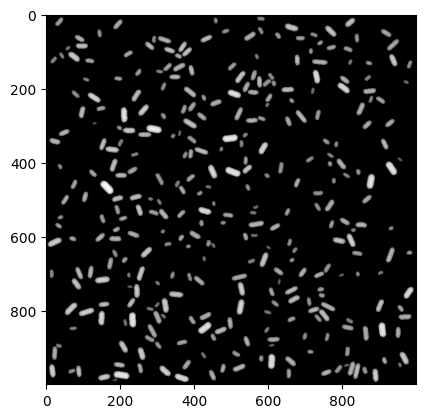

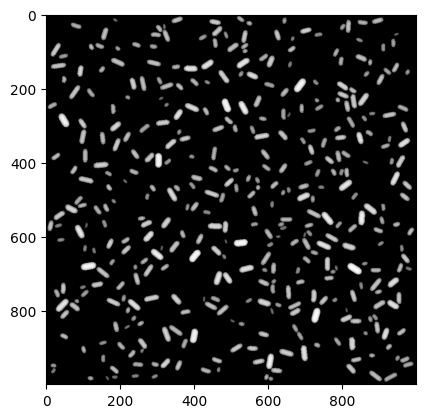

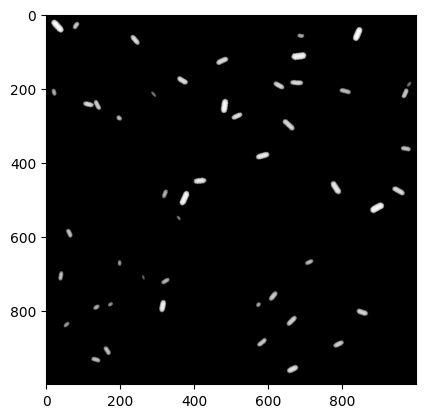

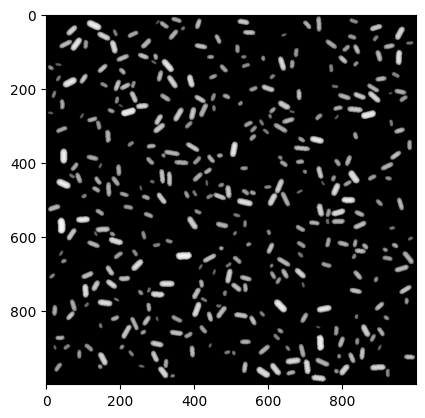

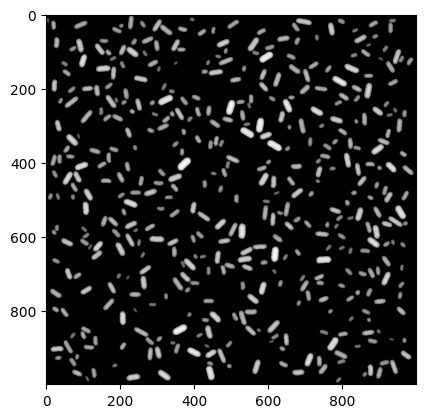

...

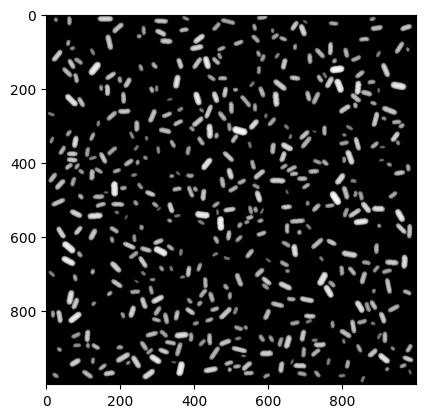

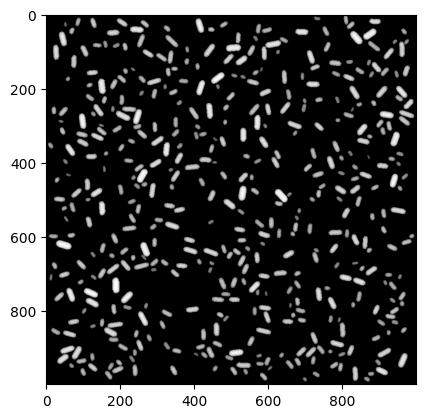

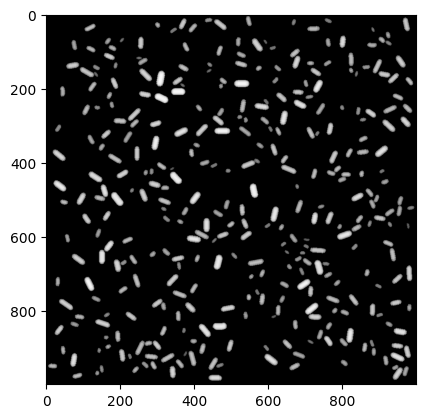

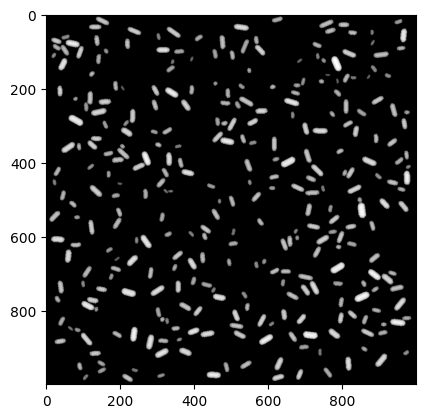

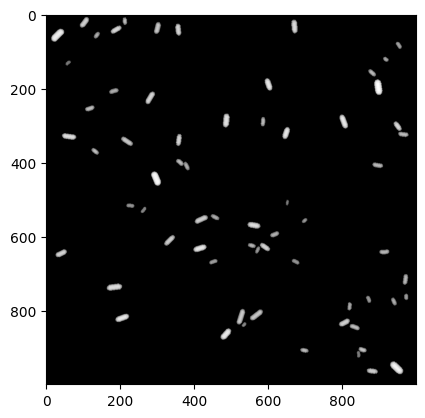

KeyboardInterrupt: 

In [15]:
for img, mask, cell_info in img_mask_pairs:
    plt.imshow(img, cmap="Greys_r")
    plt.show()

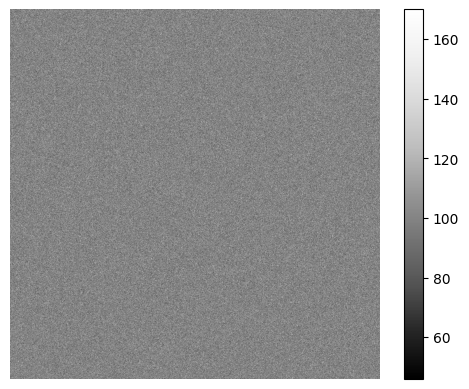

In [18]:
my_camera = Camera(baseline=100, sensitivity=2.9, dark_noise=8)
dark_image = my_camera.render_dark_image(size=img.shape);

In [125]:
dark_image.mean()

100.012302

  0%|          | 0/100 [00:00<?, ?it/s]

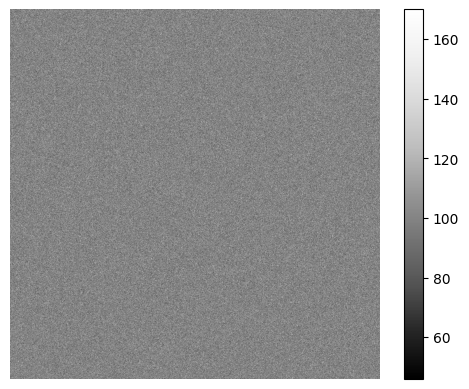

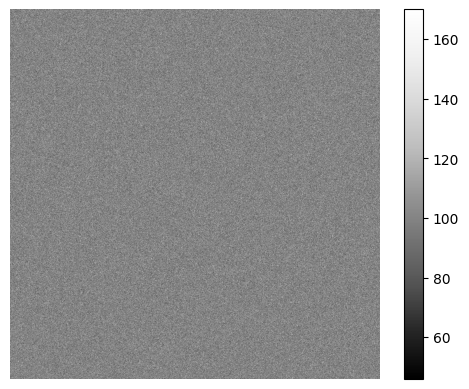

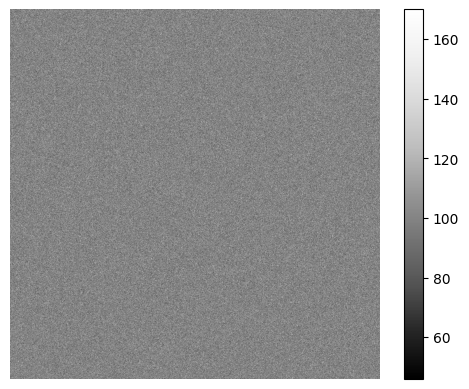

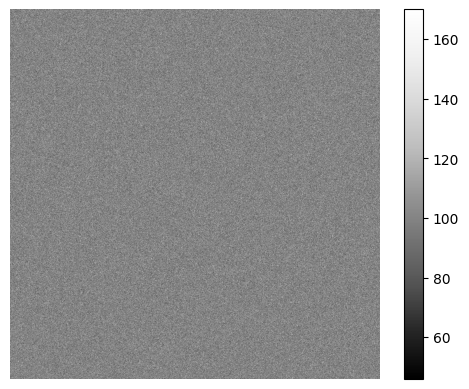

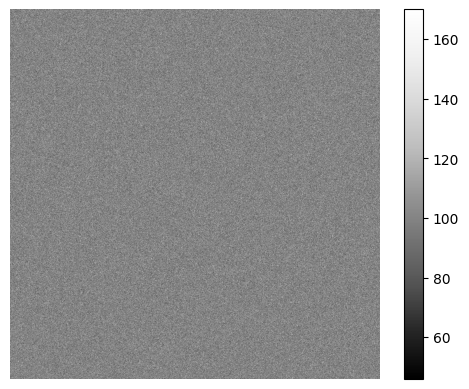

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 173 fits in uint16
  return _convert(image, np.uint16, force_copy)


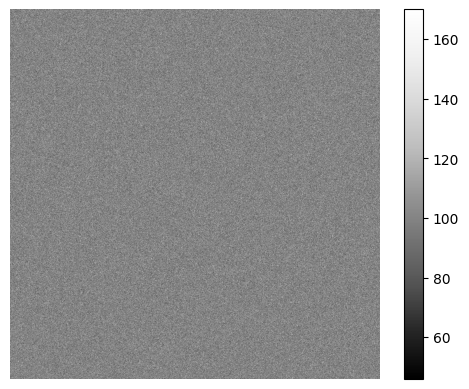

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 397 fits in uint16
  return _convert(image, np.uint16, force_copy)


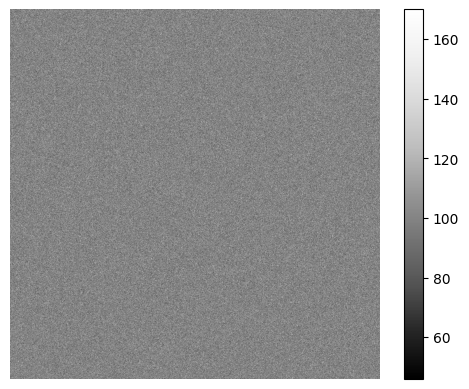

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 443 fits in uint16
  return _convert(image, np.uint16, force_copy)


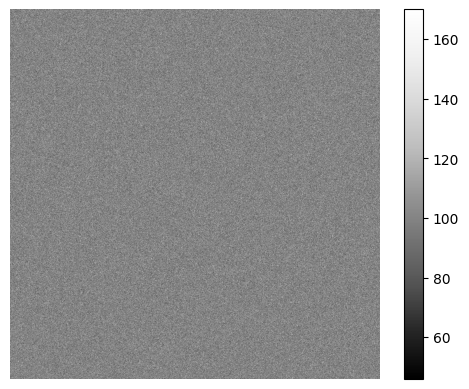

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 146 fits in uint16
  return _convert(image, np.uint16, force_copy)


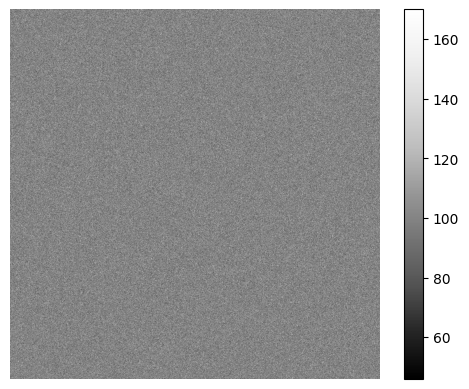

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 326 fits in uint16
  return _convert(image, np.uint16, force_copy)


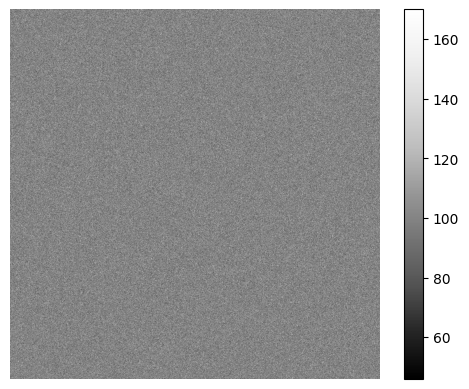

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 43 fits in uint16
  return _convert(image, np.uint16, force_copy)


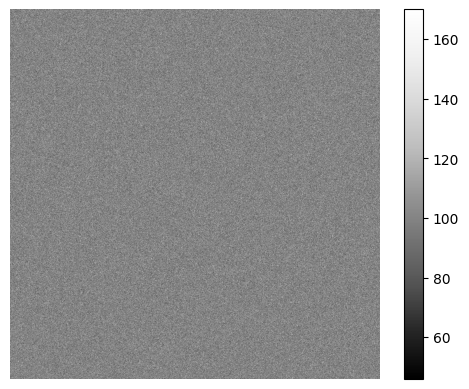

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 501 fits in uint16
  return _convert(image, np.uint16, force_copy)


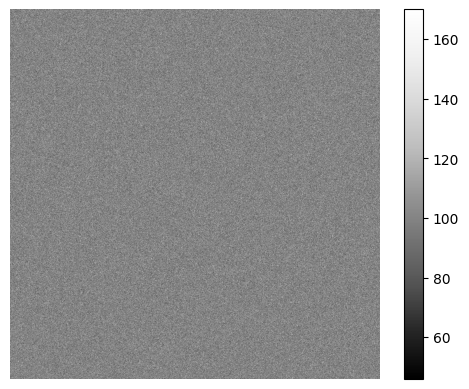

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 395 fits in uint16
  return _convert(image, np.uint16, force_copy)


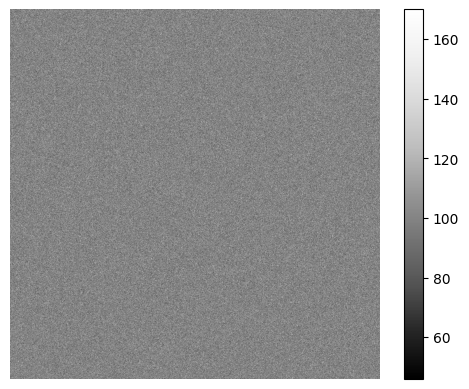

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 420 fits in uint16
  return _convert(image, np.uint16, force_copy)


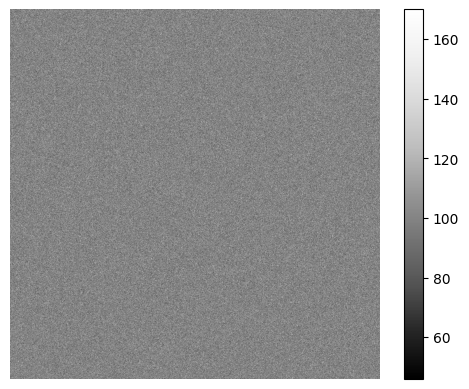

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 540 fits in uint16
  return _convert(image, np.uint16, force_copy)


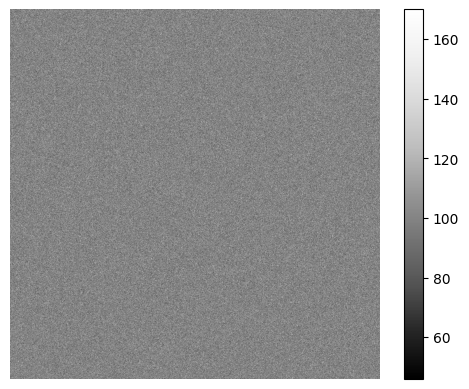

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 170 fits in uint16
  return _convert(image, np.uint16, force_copy)


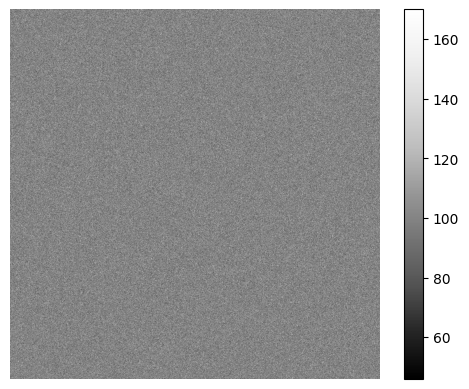

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 235 fits in uint16
  return _convert(image, np.uint16, force_copy)


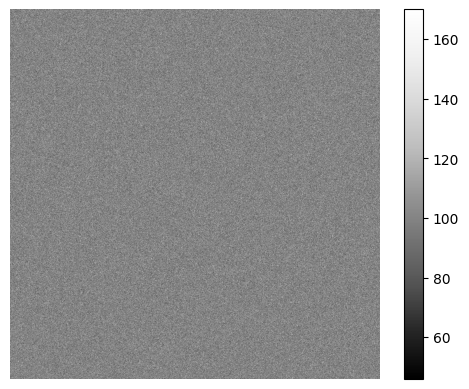

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 136 fits in uint16
  return _convert(image, np.uint16, force_copy)


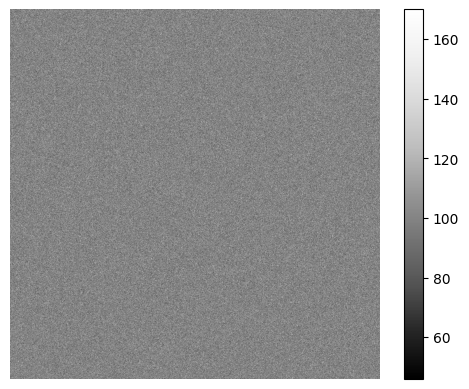

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 317 fits in uint16
  return _convert(image, np.uint16, force_copy)


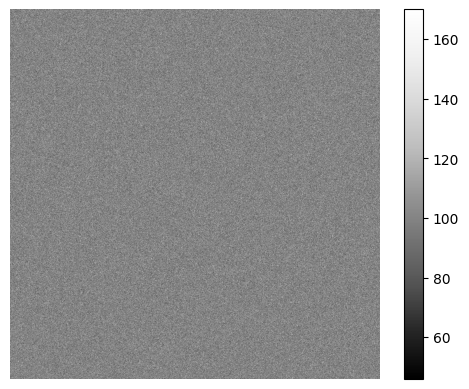

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 590 fits in uint16
  return _convert(image, np.uint16, force_copy)


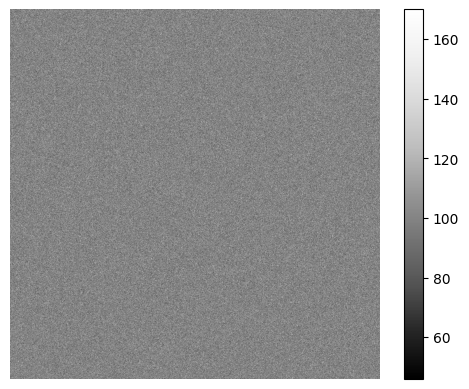

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 305 fits in uint16
  return _convert(image, np.uint16, force_copy)


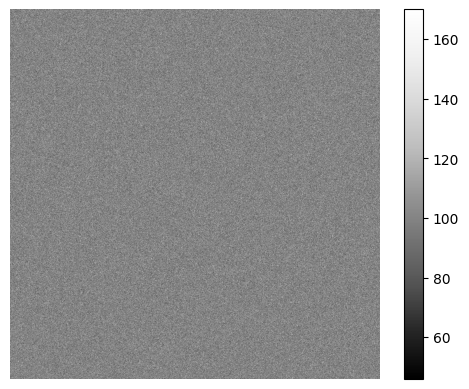

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 218 fits in uint16
  return _convert(image, np.uint16, force_copy)


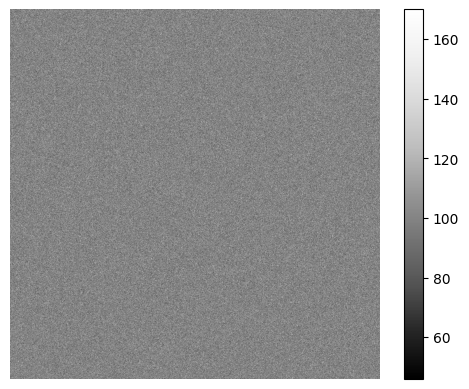

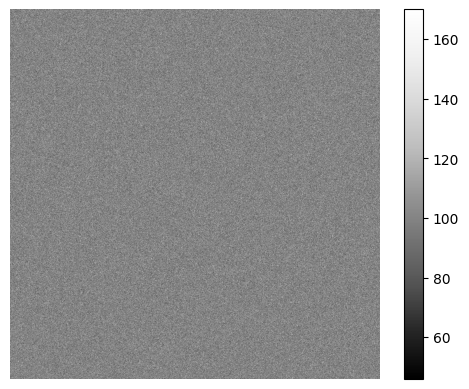

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 611 fits in uint16
  return _convert(image, np.uint16, force_copy)


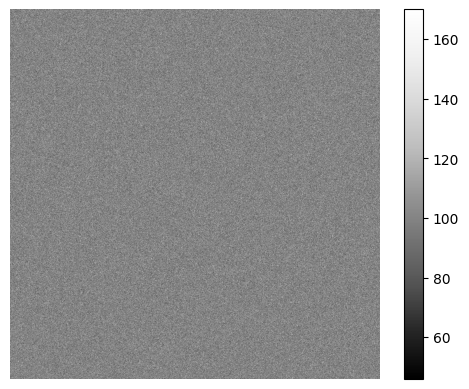

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 544 fits in uint16
  return _convert(image, np.uint16, force_copy)


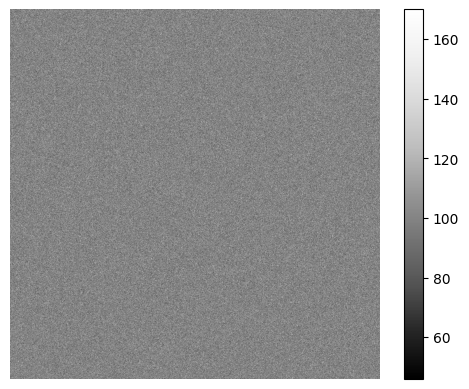

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 268 fits in uint16
  return _convert(image, np.uint16, force_copy)


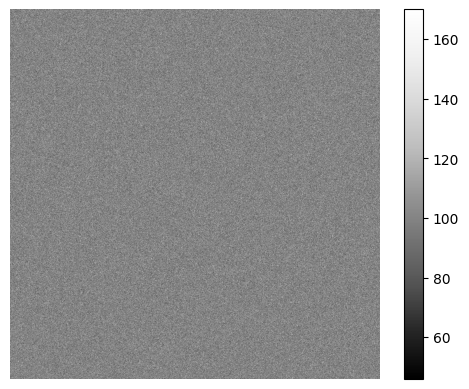

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 430 fits in uint16
  return _convert(image, np.uint16, force_copy)


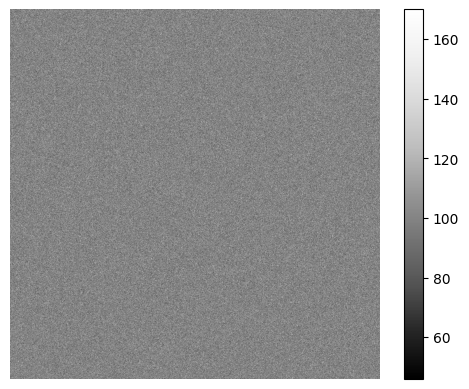

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 355 fits in uint16
  return _convert(image, np.uint16, force_copy)


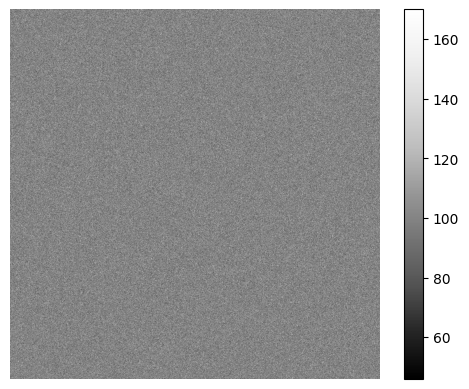

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 592 fits in uint16
  return _convert(image, np.uint16, force_copy)


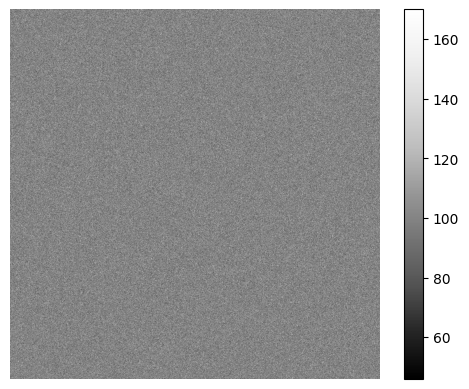

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 515 fits in uint16
  return _convert(image, np.uint16, force_copy)


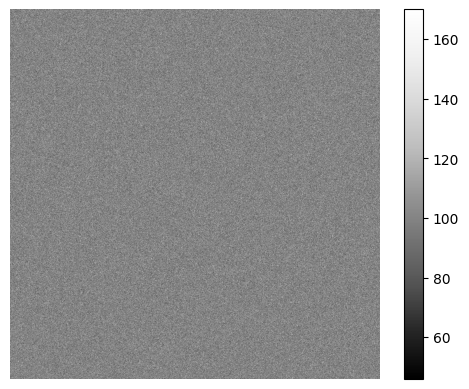

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 399 fits in uint16
  return _convert(image, np.uint16, force_copy)


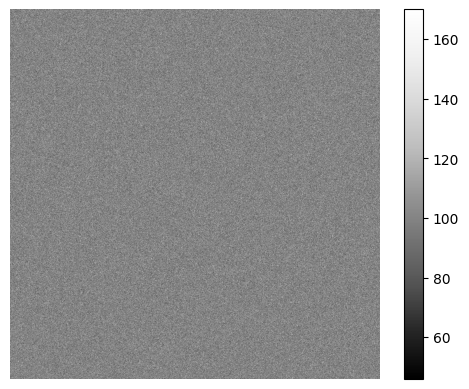

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 487 fits in uint16
  return _convert(image, np.uint16, force_copy)


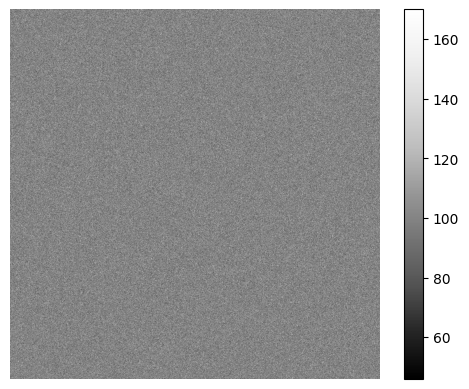

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 601 fits in uint16
  return _convert(image, np.uint16, force_copy)


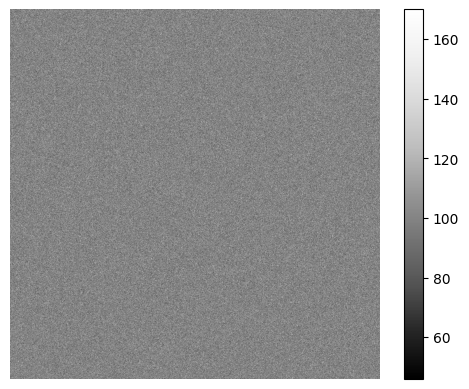

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 109 fits in uint16
  return _convert(image, np.uint16, force_copy)


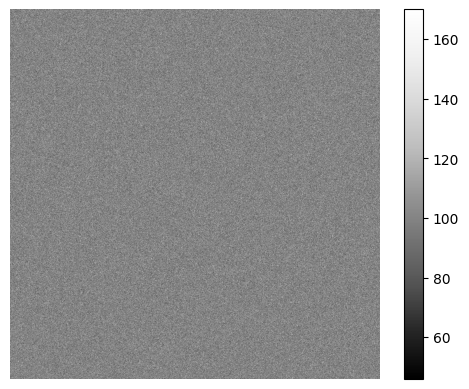

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 64 fits in uint16
  return _convert(image, np.uint16, force_copy)


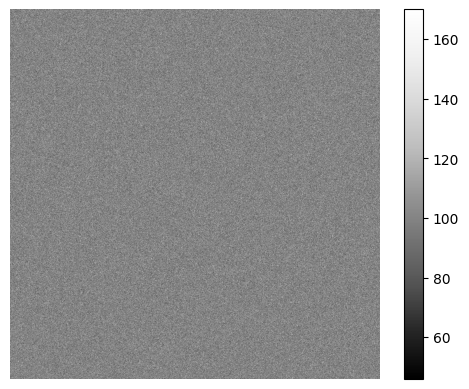

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 582 fits in uint16
  return _convert(image, np.uint16, force_copy)


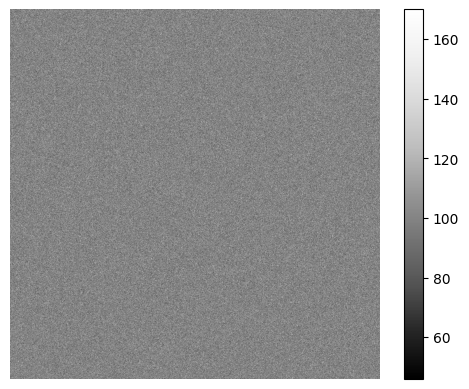

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 112 fits in uint16
  return _convert(image, np.uint16, force_copy)


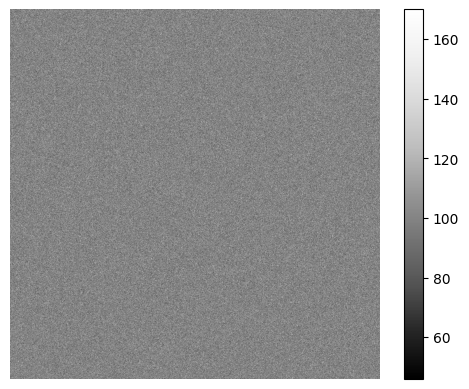

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 304 fits in uint16
  return _convert(image, np.uint16, force_copy)


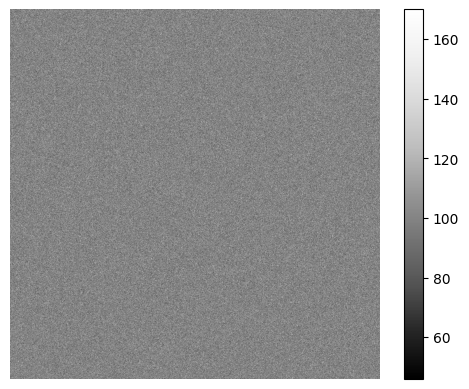

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 332 fits in uint16
  return _convert(image, np.uint16, force_copy)


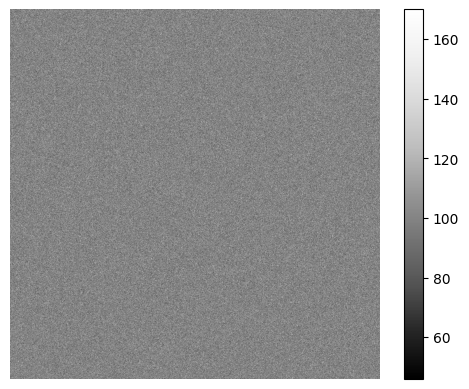

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 616 fits in uint16
  return _convert(image, np.uint16, force_copy)


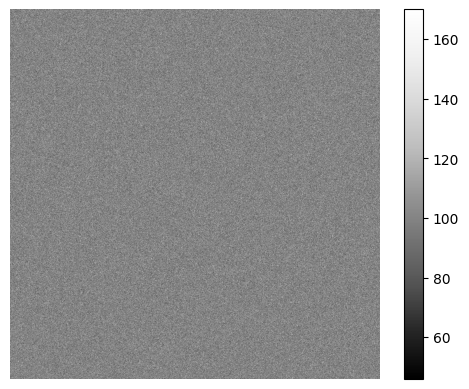

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 327 fits in uint16
  return _convert(image, np.uint16, force_copy)


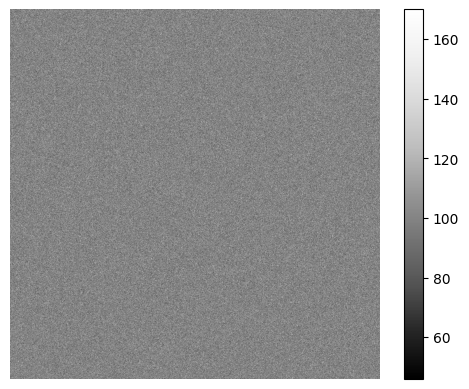

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 583 fits in uint16
  return _convert(image, np.uint16, force_copy)


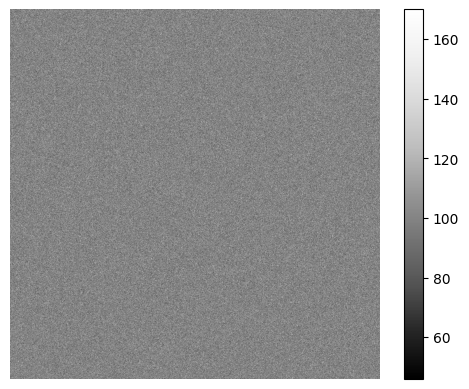

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 299 fits in uint16
  return _convert(image, np.uint16, force_copy)


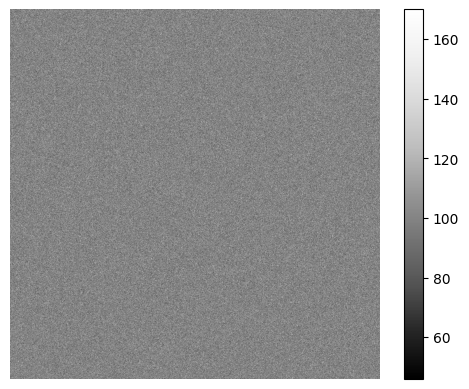

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 104 fits in uint16
  return _convert(image, np.uint16, force_copy)


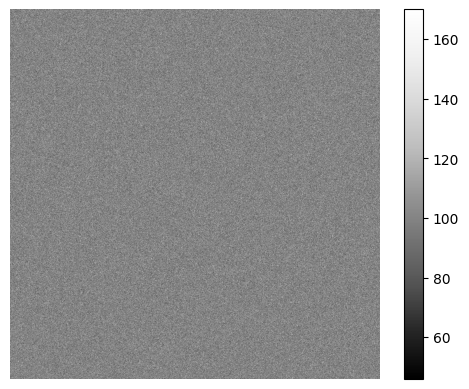

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 137 fits in uint16
  return _convert(image, np.uint16, force_copy)


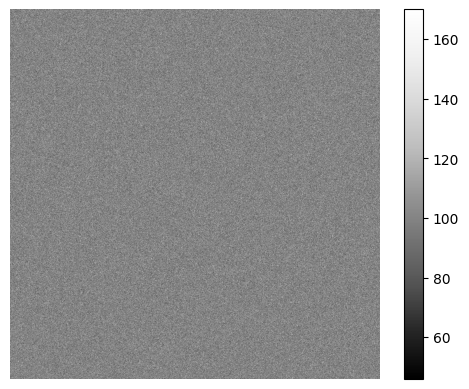

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 603 fits in uint16
  return _convert(image, np.uint16, force_copy)


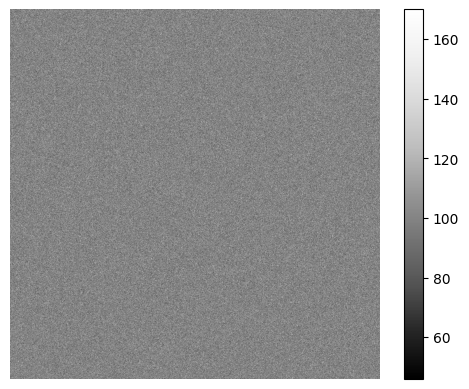

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 166 fits in uint16
  return _convert(image, np.uint16, force_copy)


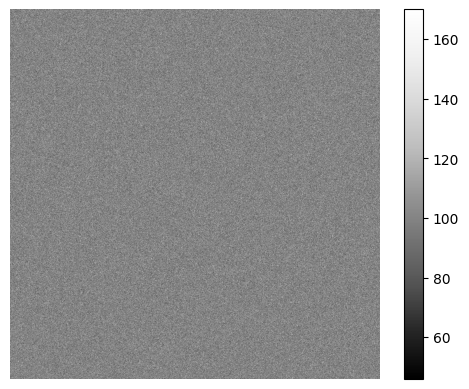

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 311 fits in uint16
  return _convert(image, np.uint16, force_copy)


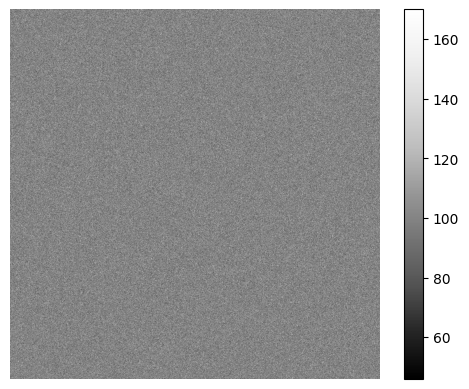

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 135 fits in uint16
  return _convert(image, np.uint16, force_copy)


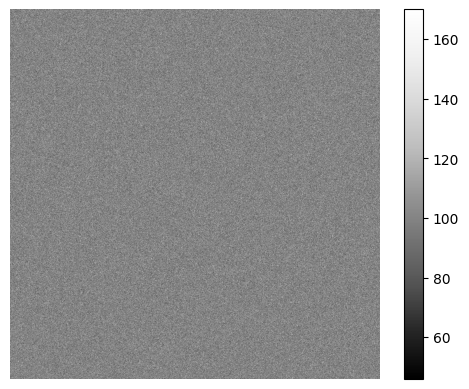

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 201 fits in uint16
  return _convert(image, np.uint16, force_copy)


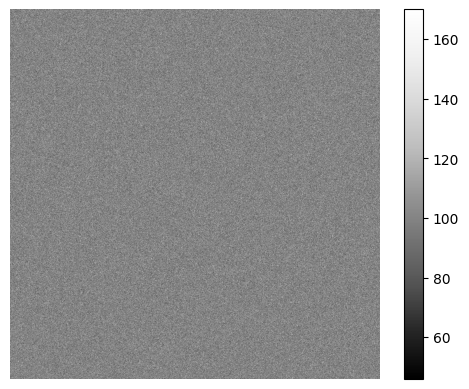

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 375 fits in uint16
  return _convert(image, np.uint16, force_copy)


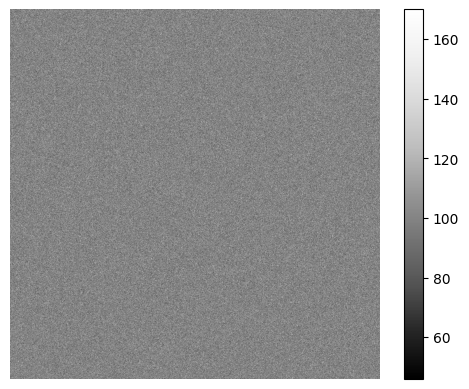

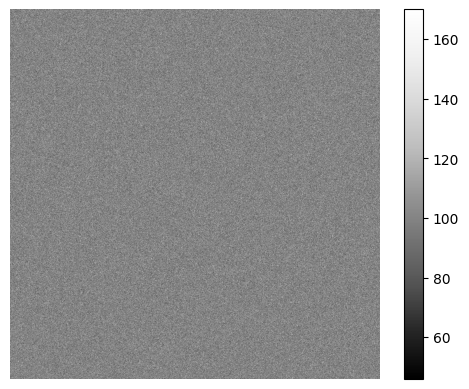

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 185 fits in uint16
  return _convert(image, np.uint16, force_copy)


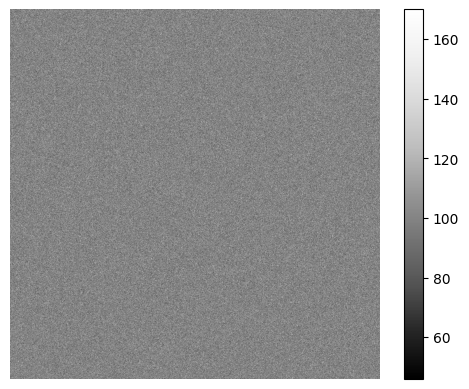

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 41 fits in uint16
  return _convert(image, np.uint16, force_copy)


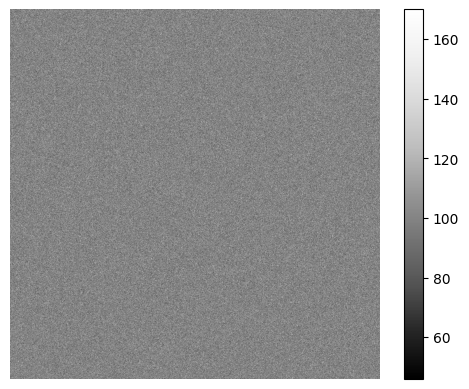

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 521 fits in uint16
  return _convert(image, np.uint16, force_copy)


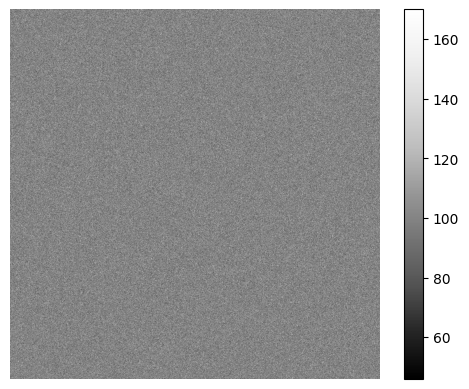

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 61 fits in uint16
  return _convert(image, np.uint16, force_copy)


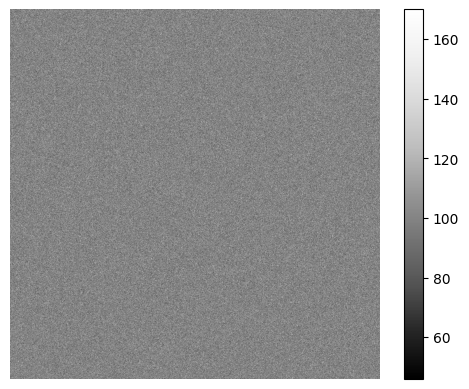

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 366 fits in uint16
  return _convert(image, np.uint16, force_copy)


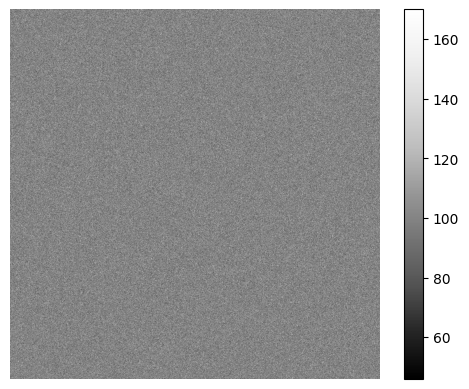

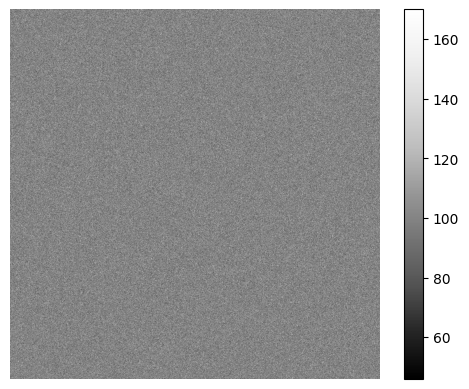

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 389 fits in uint16
  return _convert(image, np.uint16, force_copy)


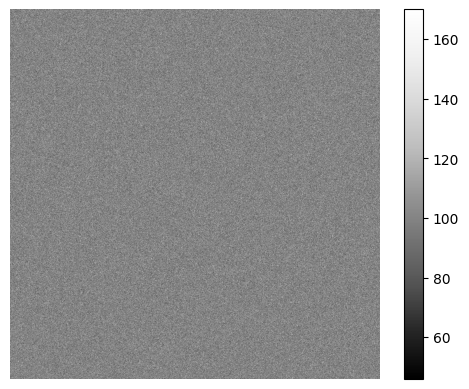

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 534 fits in uint16
  return _convert(image, np.uint16, force_copy)


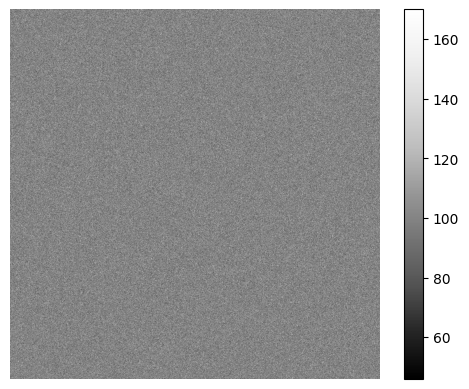

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 481 fits in uint16
  return _convert(image, np.uint16, force_copy)


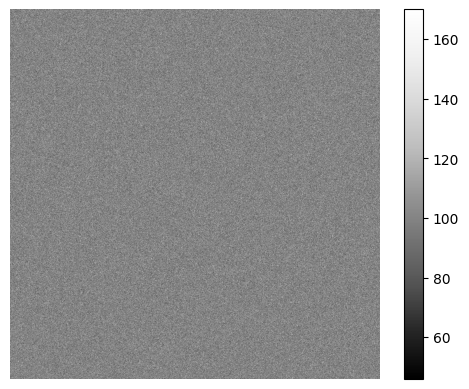

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 604 fits in uint16
  return _convert(image, np.uint16, force_copy)


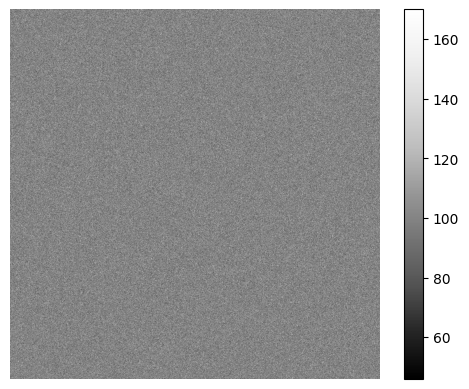

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 266 fits in uint16
  return _convert(image, np.uint16, force_copy)


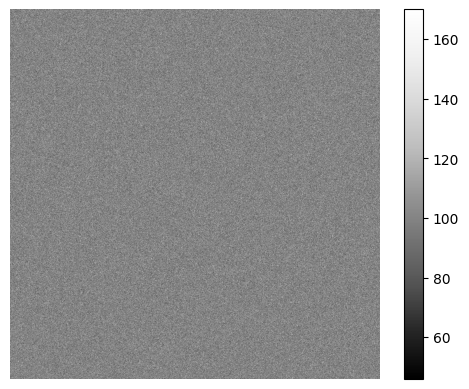

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 113 fits in uint16
  return _convert(image, np.uint16, force_copy)


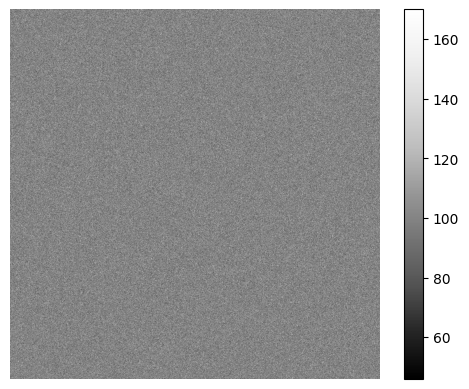

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 221 fits in uint16
  return _convert(image, np.uint16, force_copy)


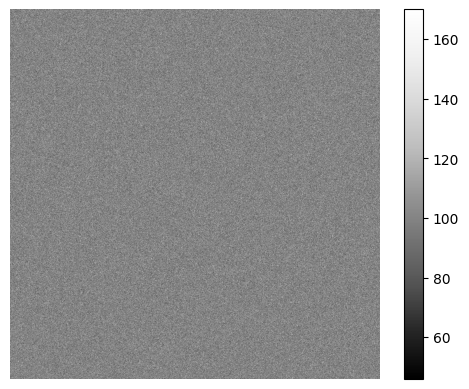

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 379 fits in uint16
  return _convert(image, np.uint16, force_copy)


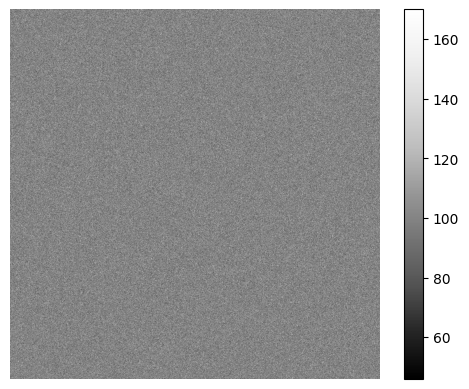

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 368 fits in uint16
  return _convert(image, np.uint16, force_copy)


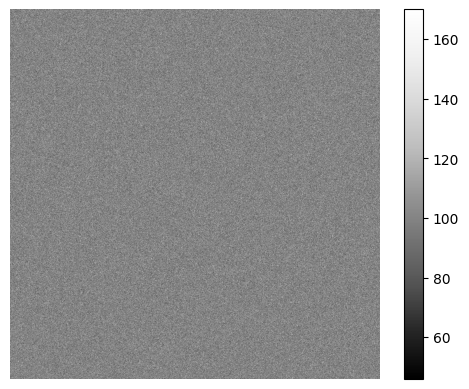

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 193 fits in uint16
  return _convert(image, np.uint16, force_copy)


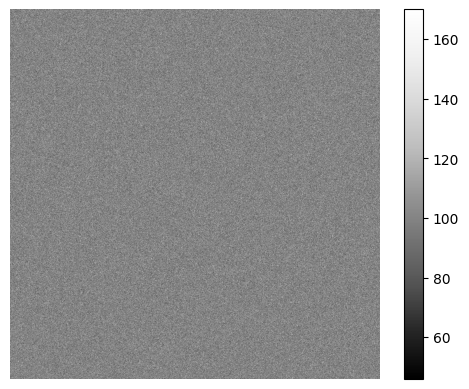

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 381 fits in uint16
  return _convert(image, np.uint16, force_copy)


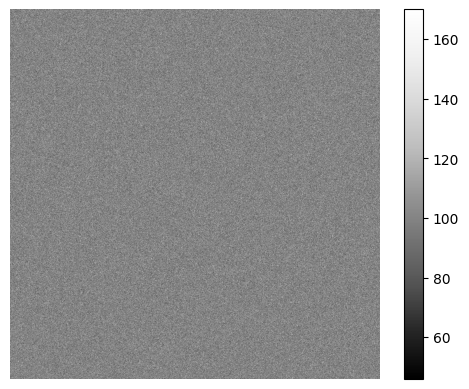

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 153 fits in uint16
  return _convert(image, np.uint16, force_copy)


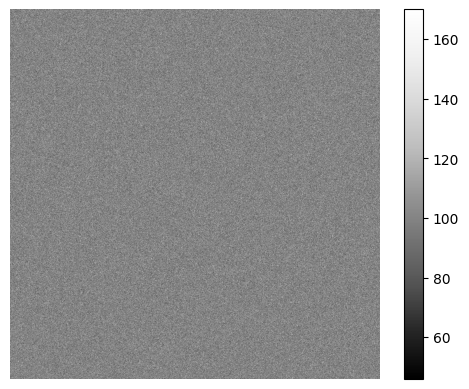

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 573 fits in uint16
  return _convert(image, np.uint16, force_copy)


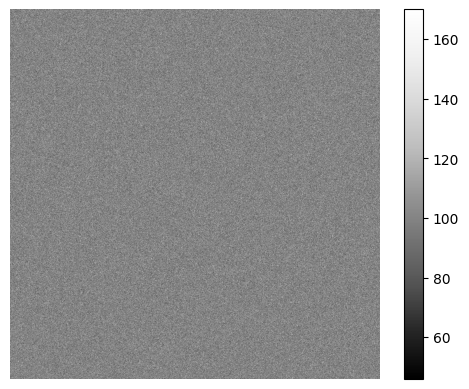

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 238 fits in uint16
  return _convert(image, np.uint16, force_copy)


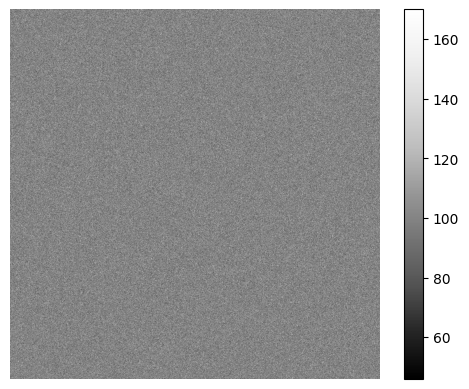

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 352 fits in uint16
  return _convert(image, np.uint16, force_copy)


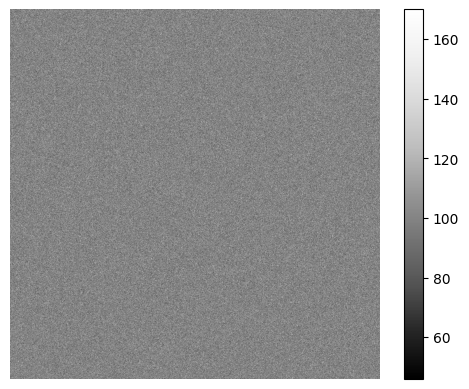

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 62 fits in uint16
  return _convert(image, np.uint16, force_copy)


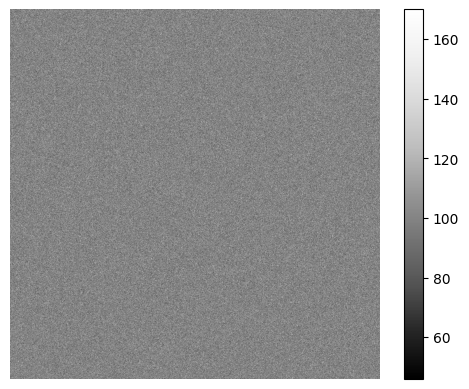

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 250 fits in uint16
  return _convert(image, np.uint16, force_copy)


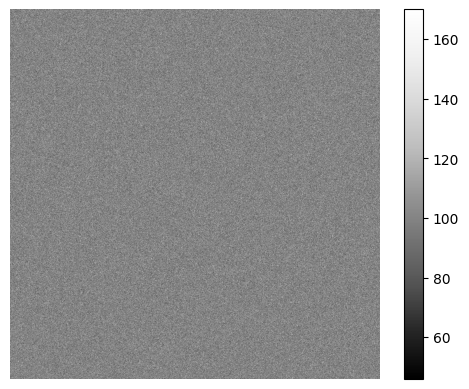

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 343 fits in uint16
  return _convert(image, np.uint16, force_copy)


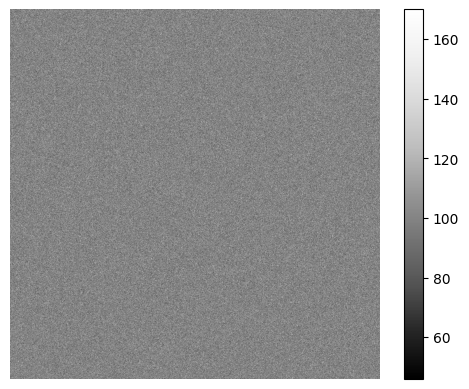

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 225 fits in uint16
  return _convert(image, np.uint16, force_copy)


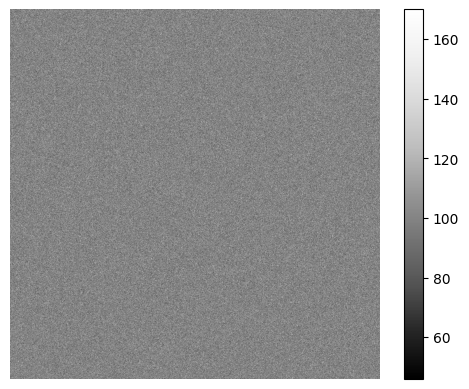

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 114 fits in uint16
  return _convert(image, np.uint16, force_copy)


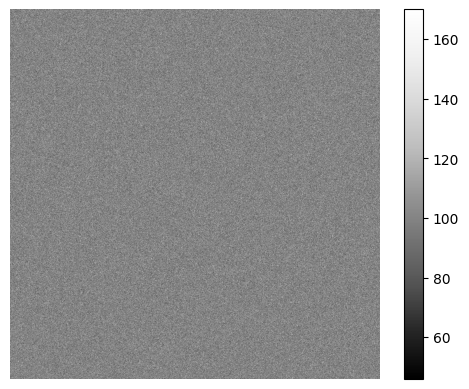

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 52 fits in uint16
  return _convert(image, np.uint16, force_copy)


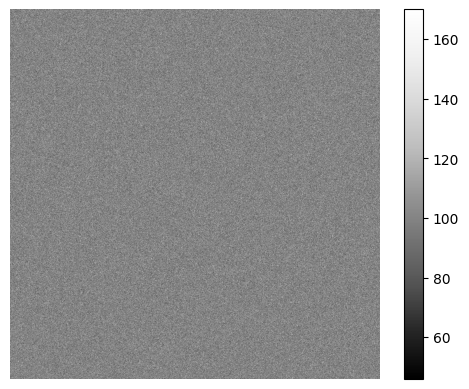

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 623 fits in uint16
  return _convert(image, np.uint16, force_copy)


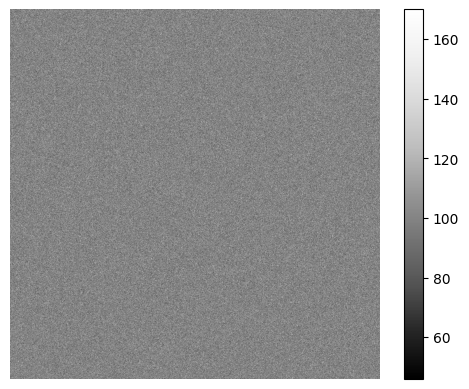

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 274 fits in uint16
  return _convert(image, np.uint16, force_copy)


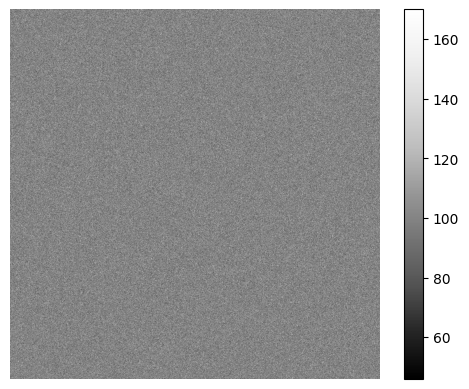

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 419 fits in uint16
  return _convert(image, np.uint16, force_copy)


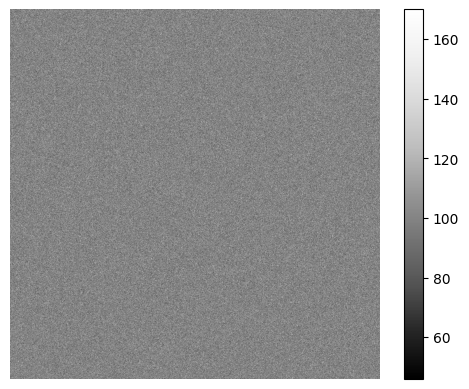

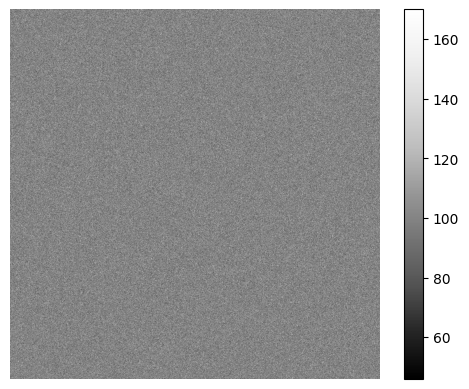

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 73 fits in uint16
  return _convert(image, np.uint16, force_copy)


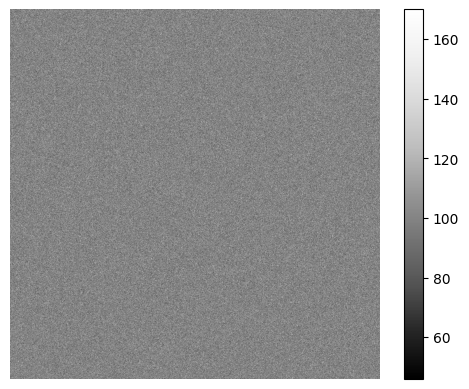

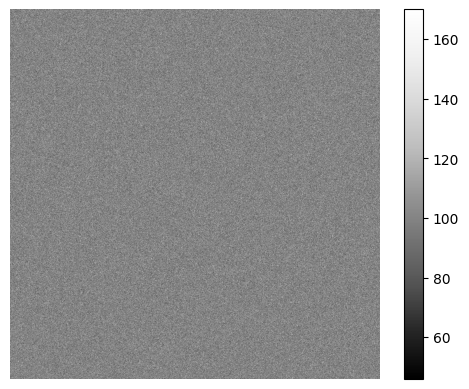

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 370 fits in uint16
  return _convert(image, np.uint16, force_copy)


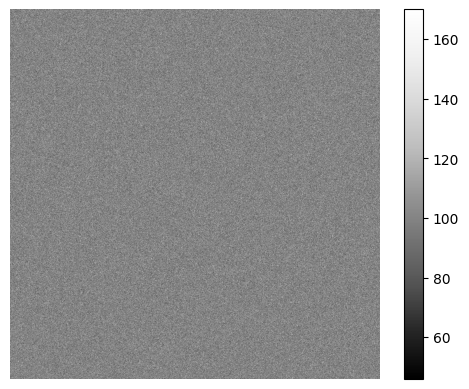

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 374 fits in uint16
  return _convert(image, np.uint16, force_copy)


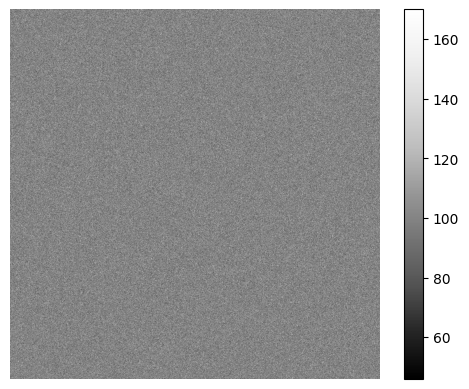

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 479 fits in uint16
  return _convert(image, np.uint16, force_copy)


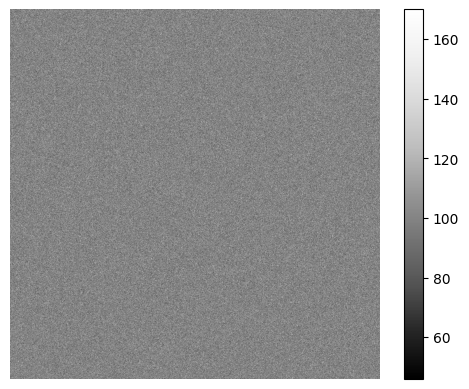

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 354 fits in uint16
  return _convert(image, np.uint16, force_copy)


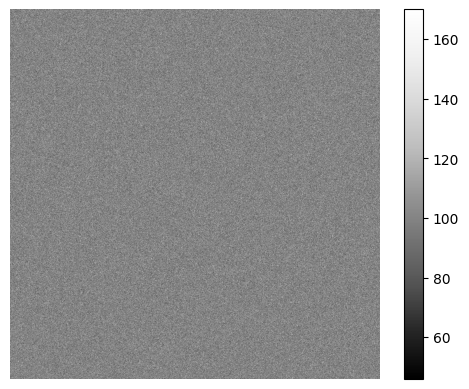

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 367 fits in uint16
  return _convert(image, np.uint16, force_copy)


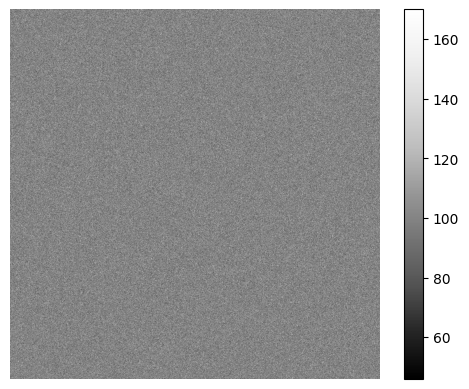

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 220 fits in uint16
  return _convert(image, np.uint16, force_copy)


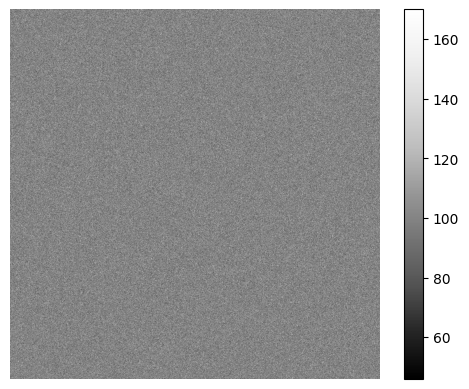

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 285 fits in uint16
  return _convert(image, np.uint16, force_copy)


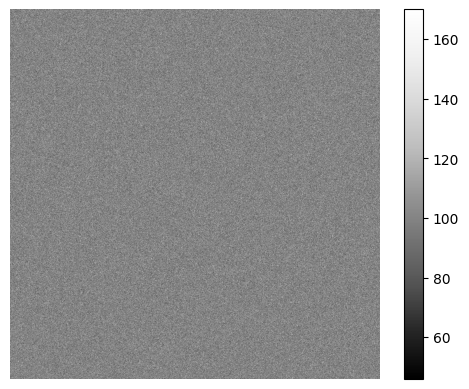

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 586 fits in uint16
  return _convert(image, np.uint16, force_copy)


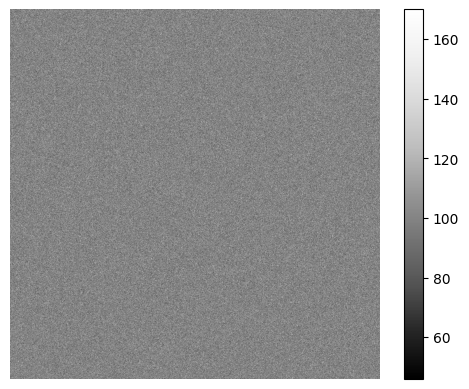

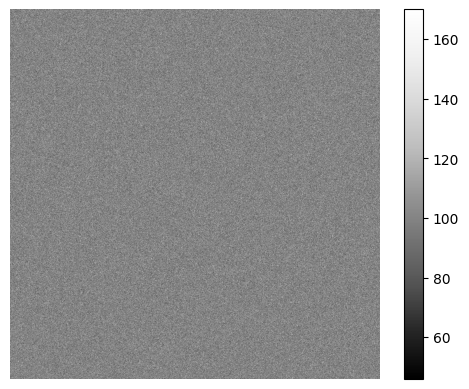

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 482 fits in uint16
  return _convert(image, np.uint16, force_copy)


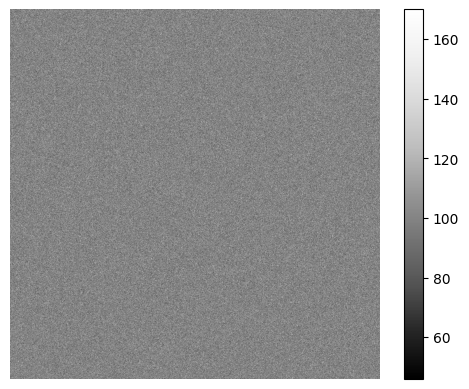

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 358 fits in uint16
  return _convert(image, np.uint16, force_copy)


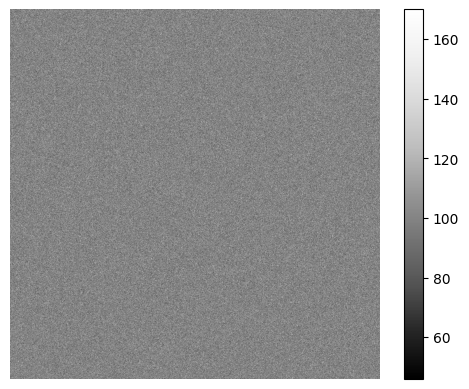

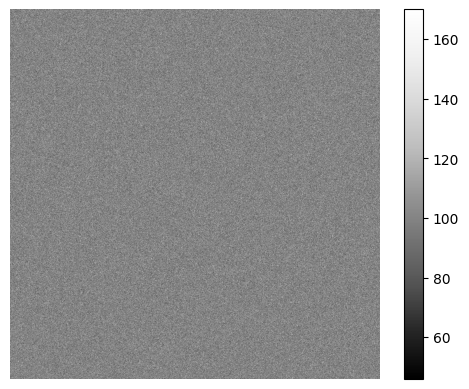

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 174 fits in uint16
  return _convert(image, np.uint16, force_copy)


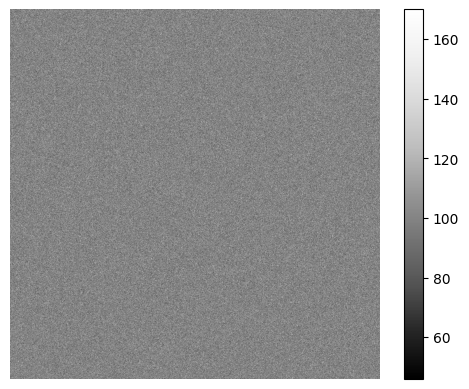

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 508 fits in uint16
  return _convert(image, np.uint16, force_copy)


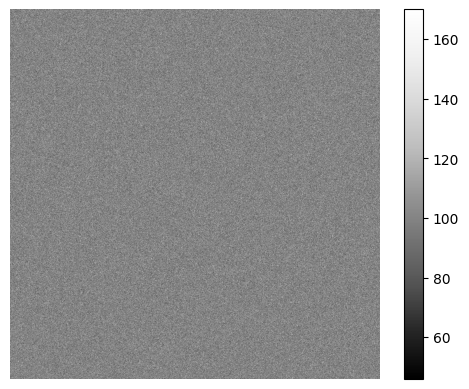

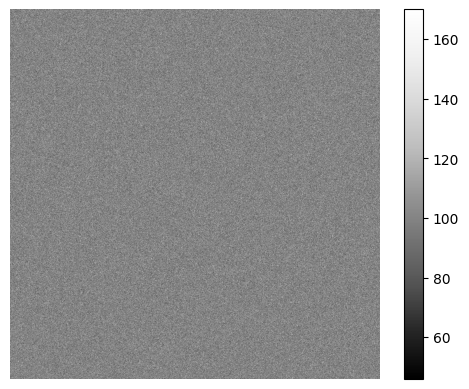

In [127]:
conv_imgs = []
for a, (image, mask, cell_info) in enumerate(tqdm(img_mask_pairs)):
    my_camera = Camera(baseline=100, sensitivity=2.9, dark_noise=8)
    dark_image = my_camera.render_dark_image(size=image.shape);
    conv_image = convolve_rescale(image, FL_PSF.kernel, rescale_factor=1/pix_scaler, rescale_int=True)
    conv_image = (dark_image + conv_image * 1000)
    conv_image /= conv_image.max()
    Image.fromarray(img_as_uint(conv_image/conv_image.max())).save(f"training_data/{str(a).zfill(4)}.png")
    Image.fromarray(img_as_uint(mask)).save(f"training_data/{str(a).zfill(4)}_masks.png")
    Image.fromarray(img_as_uint(image/image.max())).save(f"raw_images/{str(a).zfill(4)}.png")
    np.save(f"raw_images/{str(a).zfill(4)}.npy", np.array(cell_info))

In [21]:
#for a, (image, mask, cell_info) in enumerate(tqdm(img_mask_pairs)):
def generate_test_data(a, image, mask, cell_info):
    my_camera = Camera(baseline=100, sensitivity=2.9, dark_noise=8)
    dark_image = my_camera.render_dark_image(size=image.shape);
    conv_image = convolve_rescale(image, FL_PSF.kernel, rescale_factor=1/pix_scaler, rescale_int=True)
    conv_image = (dark_image + conv_image * 1000)
    conv_image /= conv_image.max()
    Image.fromarray(img_as_uint(conv_image/conv_image.max())).save(f"test_data/{str(a).zfill(4)}.png")
    Image.fromarray(img_as_uint(mask)).save(f"test_data/{str(a).zfill(4)}_masks.png")
    Image.fromarray(img_as_uint(image/image.max())).save(f"raw_test_images/{str(a).zfill(4)}.png")
    np.save(f"raw_test_images/{str(a).zfill(4)}.npy", np.array(cell_info))

In [22]:
img_mask_pairs = Parallel(n_jobs=-1)(delayed(generate_agar_pad_image)(1, 1000, density, 2) for density in tqdm(densities)) 

  0%|          | 0/100 [00:00<?, ?it/s]

In [23]:
_ = Parallel(n_jobs=-1)(delayed(generate_test_data)(a, image, mask, cell_info) for a , (image, mask, cell_info) in enumerate(tqdm(img_mask_pairs)))

  0%|          | 0/100 [00:00<?, ?it/s]

/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 569 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)


/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 287 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 48 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 183 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 398 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downca

Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)


/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 176 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)


/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 463 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 350 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 471 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 318 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)
Figure(640x480)


/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 65 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 82 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 194 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 99 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcast

Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)


/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 468 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 435 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 245 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 440 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)


/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 460 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 436 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 581 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)


/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 586 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 311 fits in uint16
  return _convert(image, np.uint16, force_copy)


Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)
Figure(640x480)


/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 489 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 581 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 85 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downcasting uint64 to uint16 without scaling because max value 443 fits in uint16
  return _convert(image, np.uint16, force_copy)
/home/georgeos/miniconda3/lib/python3.10/site-packages/skimage/util/dtype.py:492: UserWarning: Downca